# output Comparison 

In [1]:
import lime
from lime import lime_tabular
import pandas as pd
import seaborn as sns
import numpy as np
import matplotlib.pyplot as plt


In [28]:
tracers = np.array(['Rb', 'Sr', 'Y', 'Zr', 'Nb', 'Ba', 'La', 'Ce', 'Pr',
       'Nd', 'Sm', 'Eu', 'Gd', 'Tb', 'Dy', 'Ho', 'Er', 'Tm', 'Yb', 'Lu',
       'Hf', 'Ta', 'Th', 'U', 'Ni'], dtype=object)

In [29]:
morbs = "/Users/jenifervivar/Documents/GitHub/OceanBasaltML/basalts thesis/src/data/Combined_data_MORB.csv"
df_morbs = pd.read_csv(morbs)
df_morbs.head()

,SiO2,TiO2,Al2O3,FeOT,MnO,MgO,CaO,Na2O,K2O,P2O5,...,Rb,Sr,Ta,Th,U,Y,Zr,Tectonic_Setting,LATITUDE,LONGITUDE
0,50.120,1.30,15.41,9.38,0.18,8.47,12.07,2.55,0.09,0.12,...,0.94,117.0,0.154,0.109,0.048,29.4,85.7,MORB,44.27,-129.75
1,50.660,2.36,13.57,12.69,0.21,6.04,10.67,2.75,0.22,0.22,...,2.37,120.0,0.357,0.305,0.123,46.3,154.0,MORB,13.00,-104.00
2,50.504,2.25,13.87,12.85,0.24,6.10,10.62,3.06,0.19,0.25,...,2.01,131.0,0.307,0.257,0.135,40.2,133.0,MORB,13.00,-104.00
3,50.724,2.57,13.22,13.75,0.23,5.62,10.06,3.30,0.21,0.20,...,2.22,126.0,0.355,0.297,0.119,47.1,155.0,MORB,44.27,-129.55
4,50.602,2.52,13.45,13.97,0.21,5.51,9.96,3.27,0.22,0.21,...,1.97,128.0,0.324,0.267,0.114,43.3,145.0,MORB,44.66,-130.33


In [30]:

#########################################################################################################################
p_ = r"/Users/jenifervivar/Documents/GitHub/OceanBasaltML/basalts thesis/src/data/combined_datasets"
combined_df = pd.read_csv(p_)
p = "/Users/jenifervivar/Documents/GitHub/OceanBasaltML/basalts thesis/src/data/variables_target_file"
sampled_df = pd.read_csv(p)
col = sampled_df[tracers]
sampled_df.dropna(inplace = True)
combined_df.dropna(inplace = True)

c_df = combined_df.drop(["loc_keywords", "Location", "REFERENCE #", "ANALYZED MATERIAL", "SAMPLE NAME"], axis = 1)

both_df = pd.concat([c_df, df_morbs], axis = 0)
both_df.dropna(inplace = True)

#########################################################################################################################
#X = both_df[tracers]
#Y = both_df["Tectonic_Setting"]
X = combined_df[tracers]
Y = combined_df["Tectonic_Setting"]
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()
X = scaler.fit_transform(X)

#########################################################################################################################

from sklearn.model_selection import train_test_split
# X = sampled_df[col], y = sampled_df["Tectonic_setting"]
X_train, X_test, y_train, y_test = train_test_split(X, Y,\
                                                    test_size=0.3, random_state=100)

from imblearn.over_sampling import RandomOverSampler
over_sampler = RandomOverSampler(random_state=42)
X_bal, y_bal = over_sampler.fit_resample(X_train, y_train)


from sklearn.linear_model import LogisticRegression
lr = LogisticRegression(C= 100, random_state = 1, multi_class = 'ovr', solver = 'saga', penalty='l1', max_iter=5000)
lr.fit(X_bal, y_bal)
#y_result = lr.predict(X_test)

/Users/jenifervivar/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


LogisticRegression(C=100, max_iter=5000, multi_class='ovr', penalty='l1',
                   random_state=1, solver='saga')

In [31]:
combined_df.describe()

,SiO2,TiO2,Al2O3,FeOT,MnO,MgO,CaO,Na2O,K2O,P2O5,...,Yb,Lu,Hf,Ta,Th,U,Cr,Ni,LATITUDE,LONGITUDE
count,6367.000000,6367.000000,6367.000000,6367.000000,6367.000000,6367.000000,6367.000000,6367.000000,6367.000000,6367.000000,...,6367.000000,6367.000000,6367.000000,6367.000000,6367.000000,6367.000000,6367.000000,6367.000000,6367.000000,6367.000000
mean,49.351568,1.727405,15.371687,10.194997,0.182009,7.668639,10.124012,2.799445,0.853784,0.308041,...,2.422928,0.453133,3.410894,1.097856,2.382904,0.690269,267.031438,132.905333,11.306799,-26.004811
std,3.299439,0.941360,2.464115,1.957079,0.203837,3.874272,2.002580,0.797454,3.165910,0.236068,...,1.288693,5.272009,2.356666,2.846266,3.785608,0.994428,309.095847,223.669647,34.063912,108.150291
min,29.000000,0.010000,0.450000,0.600000,0.000000,0.000000,0.059691,0.000000,0.000000,0.000000,...,0.025500,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-77.513600,-180.100000
25%,47.575000,1.000000,14.120000,9.010000,0.160000,5.580000,9.150000,2.310000,0.270000,0.150000,...,1.777389,0.260000,1.930500,0.180000,0.490000,0.176988,67.000000,39.641865,-15.850000,-104.200500
50%,49.600649,1.490000,15.480000,10.051000,0.170000,7.179000,10.320000,2.770000,0.620000,0.250000,...,2.140000,0.314837,2.970000,0.550000,1.262000,0.420000,205.000000,83.000000,18.200000,-46.090000
75%,50.900000,2.295000,16.930000,11.287500,0.190000,8.660000,11.380000,3.240000,1.130000,0.410000,...,2.750000,0.409000,4.308419,1.430000,2.877500,0.840000,343.000000,148.000000,38.643144,55.730000
max,78.885514,6.580000,26.090000,26.517188,8.540000,44.300000,20.700000,8.650000,246.000000,6.080000,...,18.310000,324.819589,48.400000,176.550000,115.010000,26.100000,3481.000000,6361.612957,86.810800,178.130000


In [32]:
combined_df.columns

Index(['SAMPLE NAME', 'ANALYZED MATERIAL', 'REFERENCE #', 'SiO2', 'TiO2',
       'Al2O3', 'FeOT', 'MnO', 'MgO', 'CaO', 'Na2O', 'K2O', 'P2O5', 'Rb', 'Sr',
       'Y', 'Zr', 'Nb', 'Ba', 'La', 'Ce', 'Pr', 'Nd', 'Sm', 'Eu', 'Gd', 'Tb',
       'Dy', 'Ho', 'Er', 'Tm', 'Yb', 'Lu', 'Hf', 'Ta', 'Th', 'U', 'Cr', 'Ni',
       'LATITUDE', 'LONGITUDE', 'loc_keywords', 'Tectonic_Setting',
       'Location'],
      dtype='object')

In [24]:
combined_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 6367 entries, 0 to 6367
Data columns (total 44 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   SAMPLE NAME        6367 non-null   object 
 1   ANALYZED MATERIAL  6367 non-null   object 
 2   REFERENCE #        6367 non-null   object 
 3   SiO2               6367 non-null   float64
 4   TiO2               6367 non-null   float64
 5   Al2O3              6367 non-null   float64
 6   FeOT               6367 non-null   float64
 7   MnO                6367 non-null   float64
 8   MgO                6367 non-null   float64
 9   CaO                6367 non-null   float64
 10  Na2O               6367 non-null   float64
 11  K2O                6367 non-null   float64
 12  P2O5               6367 non-null   float64
 13  Rb                 6367 non-null   float64
 14  Sr                 6367 non-null   float64
 15  Y                  6367 non-null   float64
 16  Zr                 6367 

In [7]:
combined_df[tracers]

,Rb,Sr,Y,Zr,Nb,Ba,La,Ce,Pr,Nd,...,Ho,Er,Tm,Yb,Lu,Hf,Ta,Th,U,Ni
0,1.660000,211.000000,11.300000,17.060000,0.116000,60.000000,0.950000,2.850000,0.500000,2.810000,...,0.460000,1.290000,0.203000,1.370000,0.210000,0.610000,0.012000,0.080000,0.037000,31.800000
1,39.326866,397.421692,30.107397,172.986938,4.351138,383.858612,13.754291,33.660347,4.893323,23.672529,...,0.993851,3.129522,0.529990,3.296700,0.506941,4.048274,0.306222,1.560400,0.995827,55.026173
2,42.229248,383.035675,29.978691,187.752106,4.781171,456.180817,14.768490,35.998138,5.164318,24.628561,...,1.019020,3.209579,0.545597,3.385240,0.521601,4.423565,0.344621,1.751808,1.119837,47.489128
3,52.116680,496.979980,34.687130,215.409454,5.570963,540.318420,16.452766,39.617466,5.587615,26.501146,...,1.100270,3.477430,0.587633,3.656264,0.565124,4.716979,0.353370,1.869443,1.182308,40.964020
4,66.345688,333.838440,43.247192,303.986420,6.598315,614.444519,20.677216,50.960606,7.171643,34.102531,...,1.392379,4.392796,0.745852,4.631364,0.717250,6.677058,0.393347,2.643277,1.661968,22.113792
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6363,1.030000,50.500000,2.380000,3.600000,0.190000,7.780000,0.520000,1.100000,0.180000,0.940000,...,0.090000,0.260000,0.040000,0.280000,0.050000,0.140000,0.020000,0.040000,0.020000,973.000000
6364,5.120000,135.010000,108.800000,411.570000,12.660000,43.700000,15.480000,46.310000,7.450000,38.980000,...,3.960000,11.440000,1.690000,11.180000,1.670000,10.350000,0.910000,0.770000,0.300000,4.070000
6365,1.280000,122.900000,32.490000,95.510000,2.890000,12.830000,3.510000,10.500000,1.820000,9.790000,...,1.200000,3.440000,0.520000,3.340000,0.520000,3.430000,0.210000,0.170000,0.070000,85.140000
6366,11.760000,114.890000,144.700000,718.650000,20.600000,89.090000,26.850000,75.820000,11.720000,55.480000,...,5.210000,15.310000,2.370000,15.520000,2.330000,17.830000,1.340000,1.840000,0.690000,4.110000


In [21]:
len(combined_df)

6367

In [13]:
tracers = np.array(['Rb', 'Sr', 'Y', 'Zr', 'Nb', 'Ba', 'La', 'Ce', 'Pr',
       'Nd', 'Sm', 'Eu', 'Gd', 'Tb', 'Dy', 'Ho', 'Er', 'Tm', 'Yb', 'Lu',
       'Hf', 'Ta', 'Th', 'U', 'Ni', 'Tectonic_Setting'], dtype=object)

In [15]:
combined_df[tracers][:300]

,Rb,Sr,Y,Zr,Nb,Ba,La,Ce,Pr,Nd,...,Er,Tm,Yb,Lu,Hf,Ta,Th,U,Ni,Tectonic_Setting
0,1.660000,211.000000,11.300000,17.060000,0.116000,60.000000,0.950000,2.850000,0.500000,2.810000,...,1.290000,0.203000,1.370000,0.210000,0.610000,0.012000,0.080000,0.037000,31.800000,IAB
1,39.326866,397.421692,30.107397,172.986938,4.351138,383.858612,13.754291,33.660347,4.893323,23.672529,...,3.129522,0.529990,3.296700,0.506941,4.048274,0.306222,1.560400,0.995827,55.026173,IAB
2,42.229248,383.035675,29.978691,187.752106,4.781171,456.180817,14.768490,35.998138,5.164318,24.628561,...,3.209579,0.545597,3.385240,0.521601,4.423565,0.344621,1.751808,1.119837,47.489128,IAB
3,52.116680,496.979980,34.687130,215.409454,5.570963,540.318420,16.452766,39.617466,5.587615,26.501146,...,3.477430,0.587633,3.656264,0.565124,4.716979,0.353370,1.869443,1.182308,40.964020,IAB
4,66.345688,333.838440,43.247192,303.986420,6.598315,614.444519,20.677216,50.960606,7.171643,34.102531,...,4.392796,0.745852,4.631364,0.717250,6.677058,0.393347,2.643277,1.661968,22.113792,IAB
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
295,41.030000,692.600000,16.600000,90.200000,3.000000,614.000000,12.100000,27.300000,3.470000,16.290000,...,1.580000,0.260000,1.590000,0.240000,2.500000,0.200000,2.100000,0.700000,18.600000,IAB
296,40.660000,681.300000,15.600000,98.600000,3.100000,645.000000,13.500000,27.500000,3.620000,16.590000,...,1.660000,0.250000,1.770000,0.240000,2.600000,0.200000,2.500000,0.800000,25.200000,IAB
297,23.900000,658.100000,18.600000,94.200000,3.200000,526.000000,12.800000,25.700000,3.580000,15.600000,...,1.910000,0.280000,1.900000,0.280000,2.600000,0.200000,2.400000,0.800000,33.000000,IAB
298,26.800000,686.700000,19.600000,97.200000,2.600000,413.000000,13.800000,29.100000,3.840000,16.900000,...,1.900000,0.300000,1.760000,0.300000,2.800000,0.200000,2.600000,1.000000,15.800000,IAB


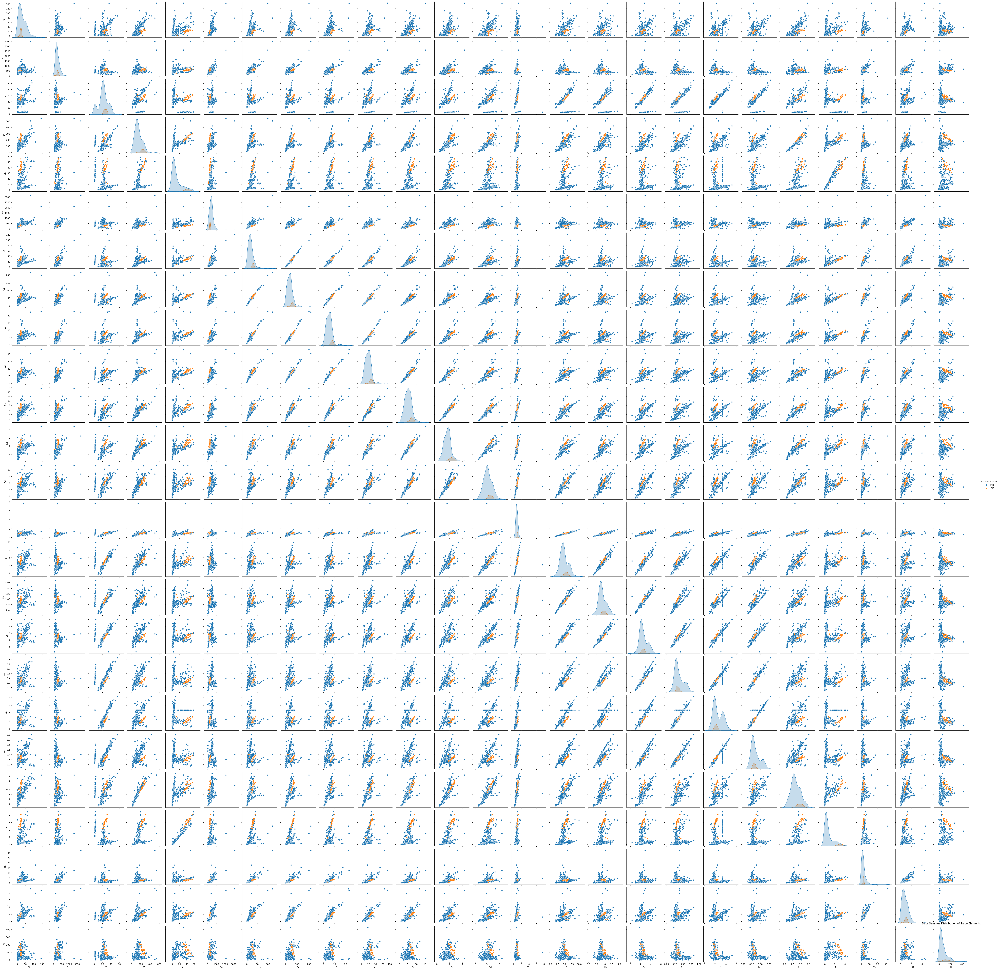

In [16]:
sns.pairplot(combined_df[tracers][:300], hue="Tectonic_Setting")
plt.title("Data Samples Distribution of Trace Elements")
plt.savefig("/Users/jenifervivar/Documents/GitHub/OceanBasaltML/basalts thesis/reports/figures/trace_dist_pairplot")
plt.show()

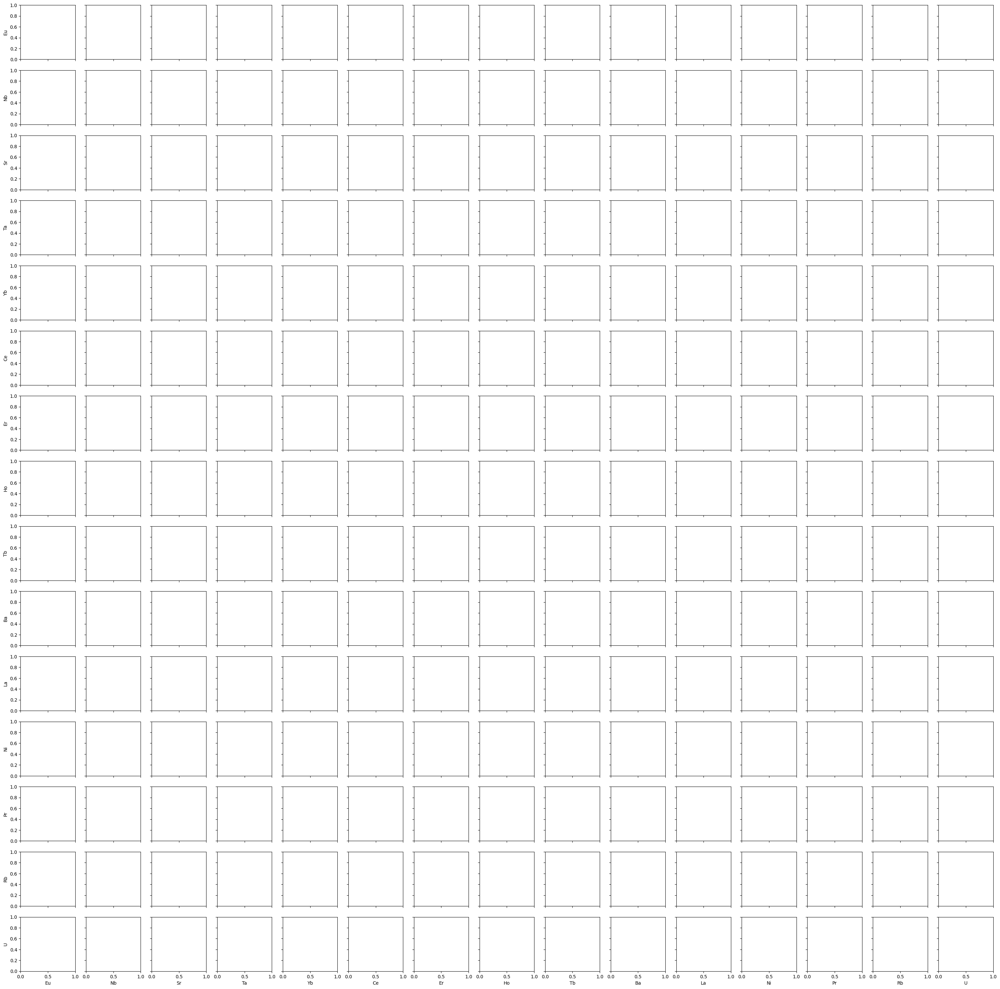

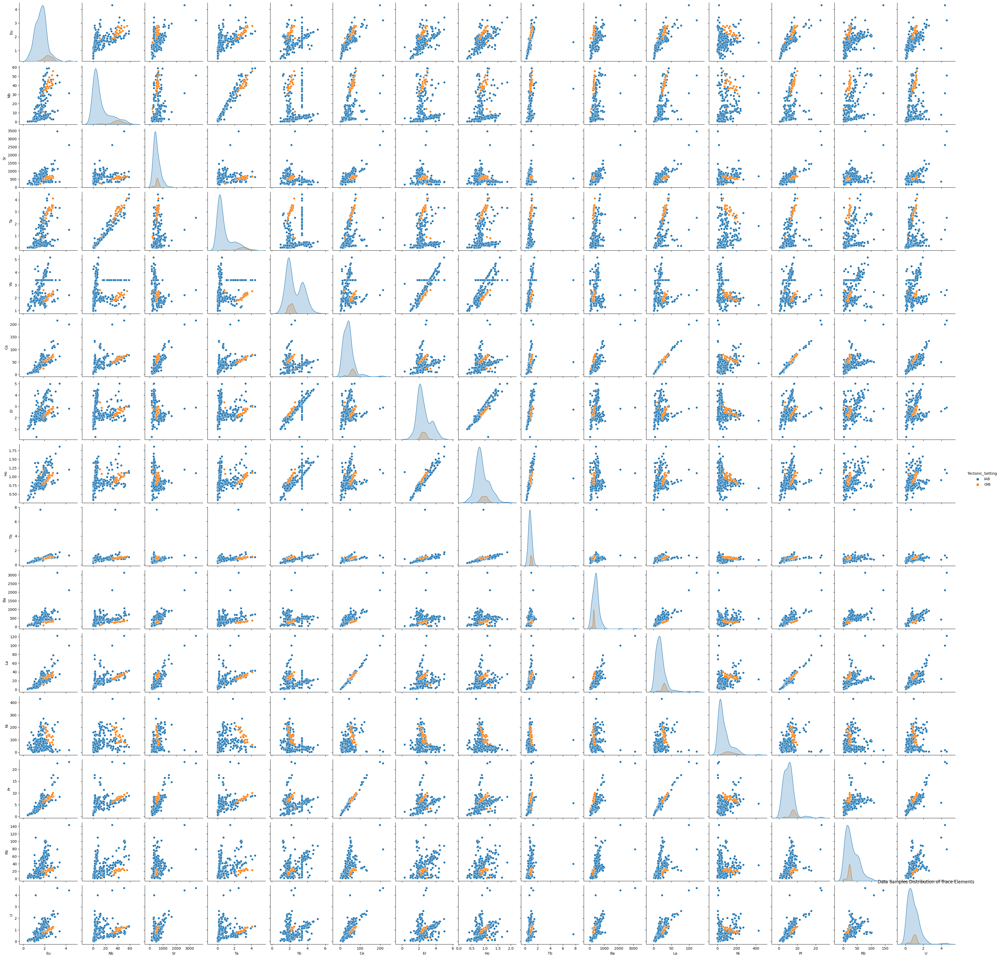

In [18]:
tracers = np.array(['Eu',"Nb","Sr", "Ta","Yb",'Ce','Er',"Ho", "Tb", "Ba", "La", "Ni", "Pr", "Rb", "U", "Tectonic_Setting"],dtype=object)
sns.pairplot(combined_df[tracers][:300], hue="Tectonic_Setting")
plt.title("Data Samples Distribution of Trace Elements")
plt.savefig("/Users/jenifervivar/Documents/GitHub/OceanBasaltML/basalts thesis/reports/figures/trace_Import_pairplo_")
plt.show()

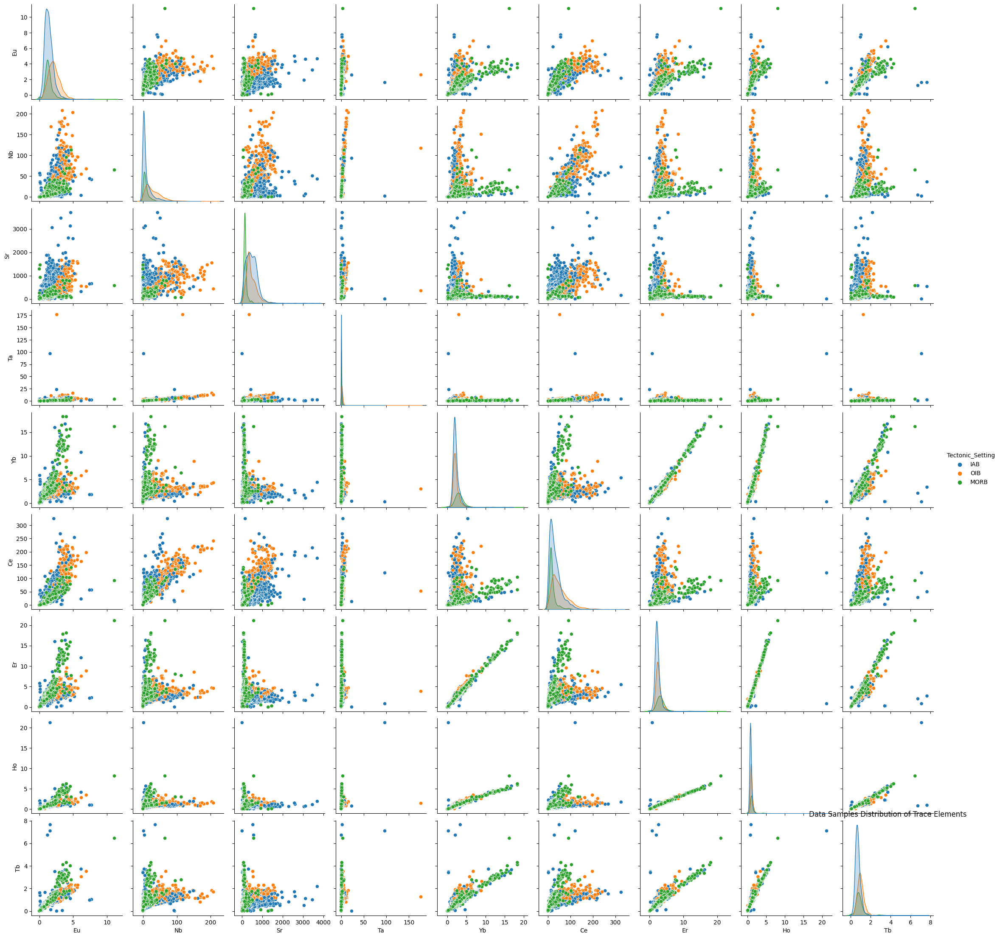

In [34]:
tracers = np.array(['Eu',"Nb","Sr", "Ta","Yb",'Ce','Er',"Ho", "Tb", "Tectonic_Setting"],dtype=object)
sns.pairplot(combined_df[tracers], hue="Tectonic_Setting")
plt.title("Data Samples Distribution of Trace Elements")
plt.savefig("/Users/jenifervivar/Documents/GitHub/OceanBasaltML/basalts thesis/reports/figures/trace_Import_pairplo_most_impor")
plt.show()

# Fitting the Logistic Regression model with MORB data only

In [8]:
from sklearn.ensemble import RandomForestClassifier
#labels = df[features].columns.to_list()
rf = RandomForestClassifier(n_estimators = 500, random_state = 1)
rf.fit(X_bal, y_bal)

RandomForestClassifier(n_estimators=500, random_state=1)

In [86]:
def df_miss(df, y_test, y_result):
    #getting only the indx where the condition is treu from y_test indexes
    #as they relate to the data frame
    indexes_ = np.where(y_test != y_result)[0] #y_test.index.values, None
    #indexes_ = indexes[indexes != None]
    
    y_test_ = y_test.values
    y_ = []
    y = []
    
    for i in range(len(y_result)):
        
        if y_result[i] != y_test_[i]:
            y_.append(y_result[i])
            y.append(y_test_[i])
        else:
            pass
    
    print(indexes_, len(indexes_), len(y_), len(y))
    
    data = {"Lon": np.array(df["LONGITUDE"].iloc[i ] for i in indexes_), \
            "Lat": np.array(df["LATITUDE"].iloc[i ] for i in indexes_),\
            "true_y": np.array(y),
            #np.array(df["Tectonic_Setting"].iloc[i - 1] for i in indexes_),
            #np.array(y),\
            #"reference": np.array([df["REFERENCE #"].iloc[i] for i in indexes_]),#,\
             "y_hat" : np.array(y_)}
    
    
    return pd.DataFrame(data, index = indexes_),  indexes_

In [87]:
combined_df.iloc[6366]

SAMPLE NAME               MELPHNX-2-79-5
ANALYZED MATERIAL                  GLASS
REFERENCE #                    NIU, 2019
SiO2                               60.08
TiO2                                1.77
Al2O3                              12.71
FeOT                               11.23
MnO                                 0.21
MgO                                 2.27
CaO                                 5.76
Na2O                                4.42
K2O                                 0.86
P2O5                                0.44
Rb                                 11.08
Sr                                112.98
Y                                 125.73
Zr                                576.01
Nb                                  17.5
Ba                                 80.34
La                                 23.22
Ce                                 65.03
Pr                                  9.84
Nd                                 48.01
Sm                                 14.44
Eu              

In [95]:
y_result_ = lr.predict(combined_df[tracers])
df_test_miss1, idx = df_miss(combined_df, combined_df["Tectonic_Setting"], y_result_)
df_test_miss1

[  73   74  273 ... 6364 6365 6366] 2993 2993 2993


/Users/jenifervivar/opt/anaconda3/lib/python3.9/site-packages/sklearn/base.py:443: UserWarning: X has feature names, but LogisticRegression was fitted without feature names
  warnings.warn(


,Lon,Lat,true_y,y_hat
73,-16.68,64.03,OIB,IAB
74,-16.68,64.03,OIB,IAB
273,-28.16171,38.43152,OIB,IAB
274,-28.1581,38.4335,OIB,IAB
275,-28.1849,38.43459,OIB,IAB
...,...,...,...,...
6361,-44.619,13.874,MORB,IAB
6363,-103.361,10.5338,MORB,OIB
6364,-103.487,10.5022,MORB,IAB
6365,-103.883,10.4218,MORB,OIB


In [96]:
df_test_miss1["true_y"].value_counts()

OIB     1854
MORB    1044
IAB       95
Name: true_y, dtype: int64

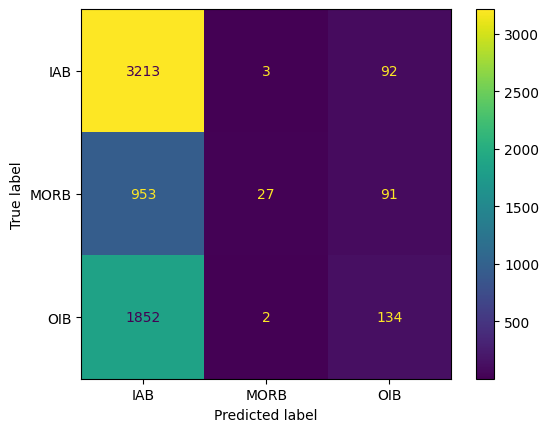

In [97]:
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
confusion_matrix_lr = confusion_matrix(sampled_df["Tectonic_setting"], y_result_)
cm_display =ConfusionMatrixDisplay(confusion_matrix = confusion_matrix_lr, display_labels=lr.classes_) #,display_labels = [False, True])
cm_display.plot()
plt.show()

# Plotting Locations for misclassified values from Logistic Regression

In [99]:
import altair as alt
from vega_datasets import data

# Since these data are each more than 5,000 rows we'll import from the URLs

url_geojson = "https://d2ad6b4ur7yvpq.cloudfront.net/naturalearth-3.3.0/ne_110m_admin_0_countries.geojson"

data_url_geojson = alt.Data(url=url_geojson, format=alt.DataFormat(property="features"))


world = alt.topo_feature("https://cdn.jsdelivr.net/npm/world-atlas@2/countries-110m.json", feature="land")


#select_label = alt.selection_single(on="mouseover", nearest=True, fields=["y_hat", "reference"], empty="none")


selection = alt.selection_multi(fields=['y_hat'])
color_ = alt.condition(selection,alt.Color('y_hat:N'),alt.value('lightgray'))

brush = alt.selection_interval() 
scales = alt.selection_interval(bind='scales')


background = alt.Chart(data_url_geojson).mark_geoshape(
    tooltip=True,
    fill="lightgray",
    stroke="black"
).properties(
    width=700,
    height=700
).project("mercator")



points = alt.Chart(df_test_miss1).mark_circle().encode(
    latitude="Lat:Q",
    longitude="Lon:Q",
    tooltip=["true_y:N", "y_hat"], #"reference:N"
   
   # size=alt.Size("y_hat:N", aggregate="count", sort="ascending"),
    #order=alt.Order(":Q", sort="descending"),
    #color=alt.condition(brush, 'y_hat:N', alt.value('lightgray')),
    color = color_,
    #alt.Color('y_hat:N'),
    shape=alt.Shape('y_hat')).add_selection(
    selection) #.add_selection(select_label)
    #alt.condition(brush, 'y_hat:N', alt.value('grey')))
    

#scatter = alt.layer(background, points).
(background+ points).configure_view(stroke=None)



#scatter | legend

alt.LayerChart(...)

In [100]:
(background+ points).save('interactingMap.html')

In [101]:
y_result_rf = rf.predict(sampled_df[tracers])
print(len(y_result_rf), len(sampled_df["Tectonic_setting"]))
df_test_miss,idx = df_miss(combined_df, sampled_df["Tectonic_setting"], y_result_rf)
df_test_miss

/Users/jenifervivar/opt/anaconda3/lib/python3.9/site-packages/sklearn/base.py:443: UserWarning: X has feature names, but RandomForestClassifier was fitted without feature names
  warnings.warn(


6367 6367
[   1    2    3 ... 6361 6362 6364] 2482 2482 2482


,Lon,Lat,true_y,y_hat
1,160.2363,55.8219,IAB,OIB
2,160.392,55.81992,IAB,OIB
3,160.36475,55.81042,IAB,OIB
4,160.38636,55.816,IAB,OIB
5,160.38128,55.8155,IAB,OIB
...,...,...,...,...
6359,-44.619,13.874,MORB,IAB
6360,-44.619,13.874,MORB,IAB
6361,-44.619,13.874,MORB,IAB
6362,-44.619,13.874,MORB,IAB


# Plotting Values from Missclassification in Random Forest

In [103]:
import altair as alt
from vega_datasets import data

# Since these data are each more than 5,000 rows we'll import from the URLs



world = alt.topo_feature("https://cdn.jsdelivr.net/npm/world-atlas@2/countries-110m.json", feature="land")


select_label = alt.selection_single(on="mouseover", nearest=True, fields=["y_hat", "reference"], empty="none")


selection = alt.selection_multi(fields=['y_hat'])
color_ = alt.condition(selection,alt.Color('y_hat:N'),alt.value('lightgray'))

brush = alt.selection_interval() 
scales = alt.selection_interval(bind='scales')

background = alt.Chart(data_url_geojson).mark_geoshape(
    tooltip=True,
    fill="lightgray",
    stroke="black"
).properties(
    width=700,
    height=700
).project("mercator")


points = alt.Chart(df_test_miss).mark_circle().encode(
    latitude="Lat:Q",
    longitude="Lon:Q",
    tooltip=["true_y:N", "y_hat"], #, "reference:N"
   
    size=alt.Size("y_hat:N", aggregate="count", sort="ascending"),
    #order=alt.Order(":Q", sort="descending"),
    #color=alt.condition(brush, 'y_hat:N', alt.value('lightgray')),
    color = color_,
    #alt.Color('y_hat:N'),
    shape=alt.Shape('y_hat')).add_selection(selection) #.add_selection(select_label)
    #alt.condition(brush, 'y_hat:N', alt.value('grey')))
    

#scatter = alt.layer(background, points)
(background + points).configure_view(stroke=None)



#scatter | legend

alt.LayerChart(...)

In [61]:
morbs = "/Users/jenifervivar/Documents/GitHub/OceanBasaltML/basalts thesis/src/data/Combined_data_MORB.csv"
df_morbs = pd.read_csv(morbs)
df_morbs.head()

,SiO2,TiO2,Al2O3,FeOT,MnO,MgO,CaO,Na2O,K2O,P2O5,...,Rb,Sr,Ta,Th,U,Y,Zr,Tectonic_Setting,LATITUDE,LONGITUDE
0,50.120,1.30,15.41,9.38,0.18,8.47,12.07,2.55,0.09,0.12,...,0.94,117.0,0.154,0.109,0.048,29.4,85.7,MORB,44.27,-129.75
1,50.660,2.36,13.57,12.69,0.21,6.04,10.67,2.75,0.22,0.22,...,2.37,120.0,0.357,0.305,0.123,46.3,154.0,MORB,13.00,-104.00
2,50.504,2.25,13.87,12.85,0.24,6.10,10.62,3.06,0.19,0.25,...,2.01,131.0,0.307,0.257,0.135,40.2,133.0,MORB,13.00,-104.00
3,50.724,2.57,13.22,13.75,0.23,5.62,10.06,3.30,0.21,0.20,...,2.22,126.0,0.355,0.297,0.119,47.1,155.0,MORB,44.27,-129.55
4,50.602,2.52,13.45,13.97,0.21,5.51,9.96,3.27,0.22,0.21,...,1.97,128.0,0.324,0.267,0.114,43.3,145.0,MORB,44.66,-130.33


In [106]:
combined_df.head()

,SAMPLE NAME,ANALYZED MATERIAL,REFERENCE #,SiO2,TiO2,Al2O3,FeOT,MnO,MgO,CaO,...,Ta,Th,U,Cr,Ni,LATITUDE,LONGITUDE,loc_keywords,Tectonic_Setting,Location
0,s_P-41/2000 [17872] / s_R-41/2000 [17697],whole rock,17872,49.840,0.690,19.520,9.58,0.190,5.830,11.810,...,0.012000,0.080000,0.037000,89.000000,31.800000,43.88000,145.53000,Subaerial (SAE),IAB,"(43.88, 145.53)"
1,s_TOL-12-01 [19963],whole rock,19963,49.684,1.243,16.292,9.88,0.156,5.446,9.331,...,0.306222,1.560400,0.995827,162.629578,55.026173,55.82190,160.23630,Subaerial (SAE),IAB,"(55.8219, 160.2363)"
2,s_TOL-12-02 [19963],whole rock,19963,50.437,1.328,17.051,9.35,0.136,4.771,9.144,...,0.344621,1.751808,1.119837,112.968681,47.489128,55.81992,160.39200,Subaerial (SAE),IAB,"(55.81992, 160.392)"
3,s_TOL-12-03 [19963],whole rock,19963,50.880,1.384,16.976,9.69,0.153,4.588,8.533,...,0.353370,1.869443,1.182308,102.395943,40.964020,55.81042,160.36475,Subaerial (SAE),IAB,"(55.81042, 160.36475)"
4,s_TOL-12-04 [19963],whole rock,19963,50.845,1.913,16.231,10.11,0.154,3.535,7.915,...,0.393347,2.643277,1.661968,28.622011,22.113792,55.81600,160.38636,Subaerial (SAE),IAB,"(55.816, 160.38636)"


In [125]:
import altair as alt
from vega_datasets import data

# Since these data are each more than 5,000 rows we'll import from the URLs


url_geojson = "https://d2ad6b4ur7yvpq.cloudfront.net/naturalearth-3.3.0/ne_110m_admin_0_countries.geojson"
#"/Users/jenifervivar/Desktop/tectonicplates-master/GeoJSON/PB2002_boundaries.json"
#"/Users/jenifervivar/Desktop/world/world.geojson"
#"/Users/jenifervivar/Downloads/map-2.geojson"
#"https://d2ad6b4ur7yvpq.cloudfront.net/naturalearth-3.3.0/ne_110m_admin_0_countries.geojson"
json = "/Users/jenifervivar/Downloads/countries.geojson"
#"/Users/jenifervivar/Downloads/custom.geo-2.json"
data_url_geojson = alt.Data(url=url_geojson, format=alt.DataFormat(property="features")) #"features"

alt.data_transformers.disable_max_rows()
world = alt.topo_feature( "/Users/jenifervivar/Desktop/World_Countries_(Generalized)", feature="land")
#"https://cdn.jsdelivr.net/npm/world-atlas@2/countries-110m.json"
#REFERENCE #
select_label = alt.selection_single(on="mouseover", nearest=True, fields=["Tectonic_Setting", "Reference #"], empty="none")


selection = alt.selection_multi(fields=['Tectonic_Setting'])
color_ = alt.condition(selection,alt.Color('Tectonic_Setting:N'),alt.value('lightgray'))

brush = alt.selection_interval() 
scales = alt.selection_interval(bind='scales')

background = alt.Chart(data_url_geojson).mark_geoshape(
    tooltip=True,
    fill="lightgray",
    stroke="black"
).properties(
    width=700,
    height=900
).project("mercator")


points = alt.Chart(combined_df).mark_circle().encode(
    latitude="LATITUDE:Q",
    longitude="LONGITUDE:Q",
    tooltip=["Tectonic_Setting:N", "REFERENCE #"], #, "reference:N"
   
    size=alt.Size("REFERENCE #:N", aggregate="count", sort="ascending"),
    #order=alt.Order(":Q", sort="descending"),
    #color=alt.condition(brush, 'y_hat:N', alt.value('lightgray')),
    color = color_,
    #alt.Color('y_hat:N'),
    shape=alt.Shape('Tectonic_Setting')).add_selection(selection) #.add_selection(select_label)
    #alt.condition(brush, 'y_hat:N', alt.value('grey')))
    

#scatter = alt.layer(background, points)
(background + points).configure_view(stroke=None)



#scatter | legend

alt.LayerChart(...)

In [126]:
(background+ points).save('interactingMapAllPoints.html')

In [6]:
import geopandas as gpd
p = "/Users/jenifervivar/Desktop/World_Countries_(Generalized)"
p1 = "/Users/jenifervivar/Desktop/tectonicplates-master"
#p = "/Users/jenifervivar/Desktop/World_Countries__Generalized_.shp"

world_map = gpd.read_file(p1)
world_map1=gpd.read_file(p)

# Are MORB data actually MORBS?

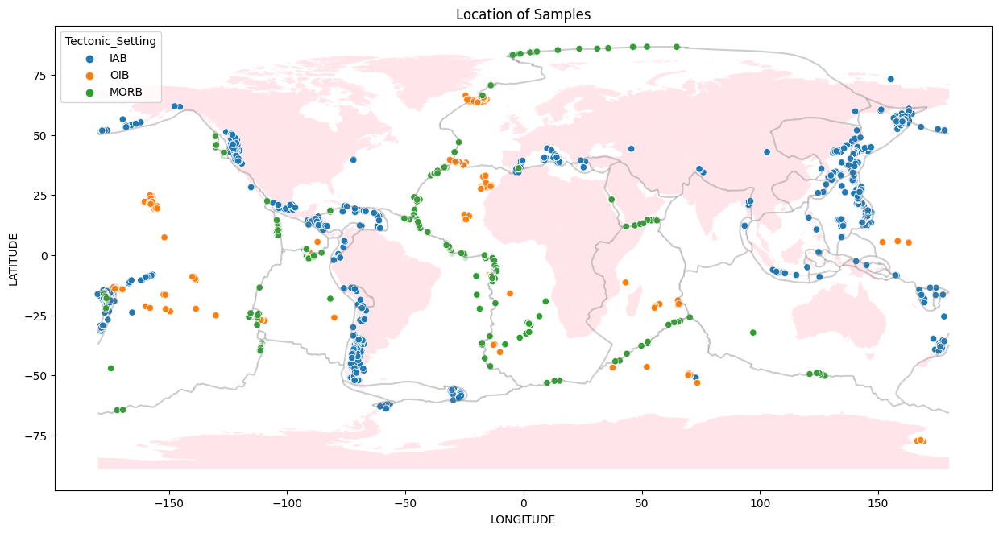

In [7]:
fig, ax = plt.subplots(figsize=(15,15))
world_map1.plot(ax=ax, alpha=0.4, color='pink')
world_map.plot(ax=ax, alpha=0.4, color='grey')

#corr= np.where(y_test == y_result)

#plt.scatter([sampled_df["LONGITUDE"].iloc[i] for i in corr ], [sampled_df["LATITUDE"].iloc[i] for i in corr], c = "grey")



sns.scatterplot(data=combined_df, x="LONGITUDE", y="LATITUDE", hue = "Tectonic_Setting",\
                ax = ax, sizes=(40, 400))
#sns.scatterplot(data=df_morbs, x="LONGITUDE", y="LATITUDE", hue="Tectonic_Setting", \
                #ax = ax, alpha=0.4, sizes=(40, 400))
plt.title("Location of Samples")
plt.savefig(f"/Users/jenifervivar/Documents/GitHub/OceanBasaltML/basalts thesis/reports/figures/allPointsStatic")
plt.show()